In [854]:
# IMPORTS 
##########
##########
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

from astropy.visualization import hist
from astropy.stats import histogram, sigma_clip
from astropy.io import fits
from astropy.coordinates import SkyCoord
import astropy.units as u

import ccdproc
from ccdproc import subtract_overscan
from ccdproc import trim_image
from ccdproc import CCDData

import os
import sys
sys.path.insert(0,'./ccd_red_notebooks/ccd-reduction-and-photometry-guide/notebooks/')
from convenience_functions import show_image

import imexam

sys.path.insert(1,"/Applications/SAOImageDS9.app/Contents/MacOS/")

from photutils.aperture import CircularAperture
from photutils.aperture import CircularAnnulus
from photutils.aperture import aperture_photometry
from photutils.detection import DAOStarFinder
from astropy.stats import sigma_clipped_stats

from sklearn.linear_model import LinearRegression

import sfdmap
import extinction

In [8]:
#CLD this cell contains the path to images in my home dir. change to access images in your dir
path_data = '../../../../imaging/reduced_data/'

# Problem 1

I will start by looking at different stars in the same field. I will then choose a star from that field to use for the other investigations, which I will denote by putting an annulus around. I will then look at the PSF of that star, but in images that were taken over a range of times. 

Additionally, I will keep the filter (V) consistent through out.

I will begin by looking at a085 for multiple stars then a085, a206, a241 for same star different times, and finally a206 and a241 for similar times but different airmasses.

In [1015]:
viewer = imexam.connect(path='/Volumes/Macintosh HD/Applications/SAOImageDS9.app/Contents/MacOS/ds9')

In [1016]:
viewer.scale()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/carriedrake/Documents/Graduate School/obs_astro/imaging/reduced_data/a085otbf.fits
xc=823.8361	yc=1088.2265
Background per pixel: 125.15724080255454
Max. pix. flux =  5390.680
amp =  5887.663
fwhm =     4.107


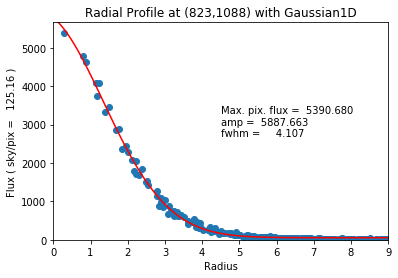

xc=1044.8044	yc=1043.2178
Background per pixel: 128.56584178095153
Max. pix. flux =  7126.969
amp =  7697.357
fwhm =     4.130


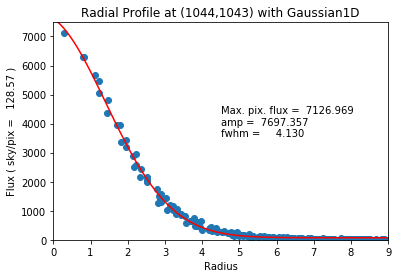

xc=1240.9227	yc=969.6444
Background per pixel: 122.06013741152113
Max. pix. flux =   941.311
amp =  1012.434
fwhm =     4.014


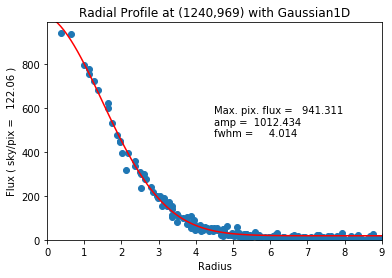

xc=781.1232	yc=987.5868
Background per pixel: 125.43861516991628
Max. pix. flux =  1877.510
amp =  2181.481
fwhm =     4.211


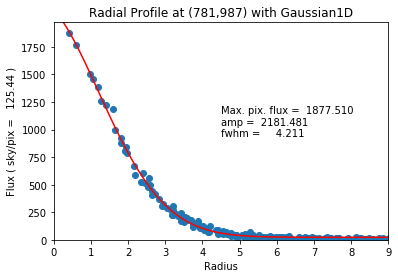

In [29]:
viewer.imexam()

The PSF for all four stars in the same frame are almost exactly alike.

I will use the last star as my base star for the next excersice.

In [36]:
postion = [(781, 987)]
apreture = CircularAperture(postion, r=15)

In [31]:
a085 = fits.getdata(path_data+'a085otbf.fits')

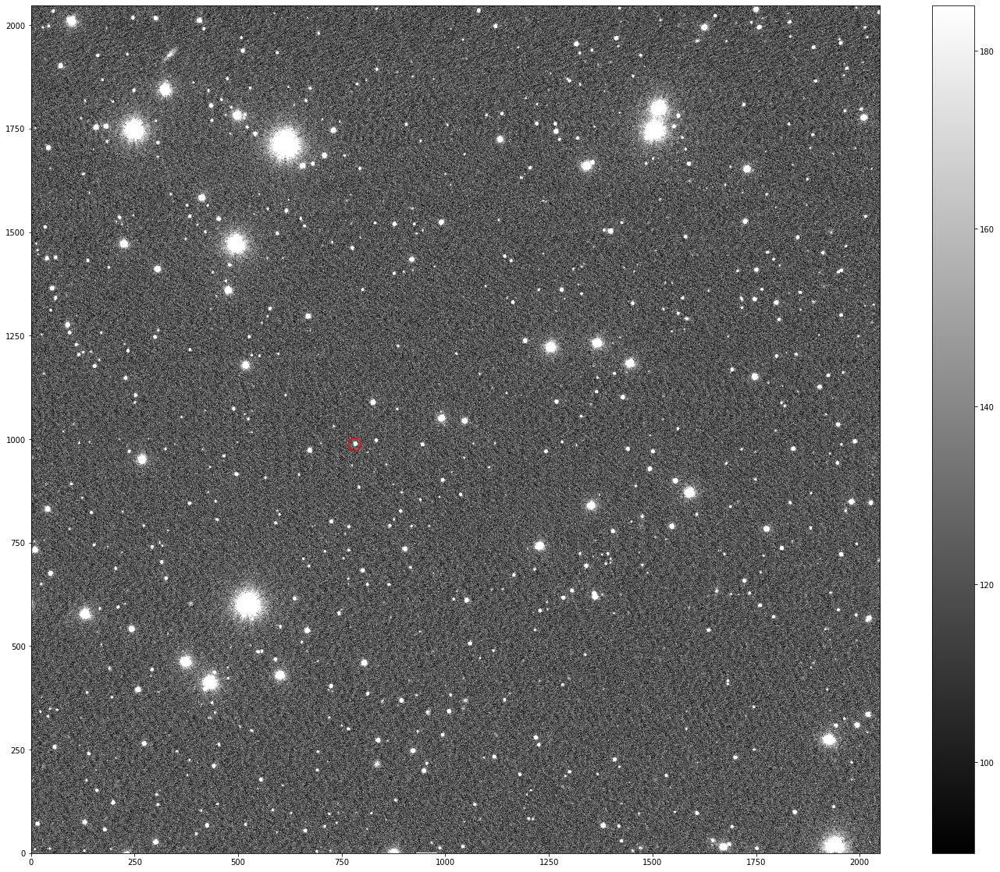

In [38]:
fig,ax = plt.subplots(figsize=(30,20))
show_image(a085, cmap='gray', ax=ax, fig=fig)
apreture.plot(color='r',lw=1.5);


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/carriedrake/Documents/Graduate School/obs_astro/imaging/reduced_data/a085otbf.fits
xc=781.1232	yc=987.5868
Background per pixel: 125.43860587864128
Max. pix. flux =  1877.510
amp =  2181.481
fwhm =     4.211


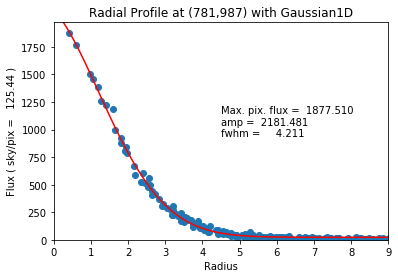

In [40]:
viewer.imexam()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/carriedrake/Documents/Graduate School/obs_astro/imaging/reduced_data/a206otbf.fits
xc=716.5458	yc=975.5569
Background per pixel: 63.95728102922823
Max. pix. flux =  1250.970
amp =  1737.693
fwhm =     3.583


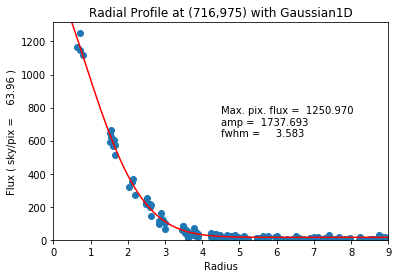

In [41]:
viewer.imexam()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/carriedrake/Documents/Graduate School/obs_astro/imaging/reduced_data/a241otbf.fits
xc=630.5481	yc=978.3425
Background per pixel: 99.26540535799919
Max. pix. flux =   367.934
amp =   324.026
fwhm =     4.751


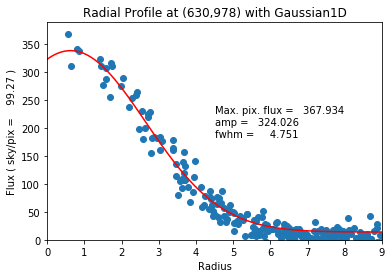

In [42]:
viewer.imexam()

For context, I will be comparing the FWHM that as is read out by imexam and placed on all of the graphs.

For stars that are in the same frame/across the chip (the first four plots), the PSF FWHM looks exactly the same.

For the same star at different times (the next three), the FWHM degrades throughout the night, most likely due to increasing airmass. This is seen in the last two plots of this set, which were taken at similar times (8:18 and 9:35, honestly as similar as I could get them based on the data) but different airmasses (1.52 and 2.21 respectively). These two plots have the biggest difference between them of any of the plots. 

# Problem 2

The frames labeld linearity span 74-80 based on the log.txt document.

In [21]:
lin_data = []
time = []
for i in range((80-74)+1):
    file = fits.open(path_data+'a0'+str(i+74)+'.fits')
    header = file[0].header
    time.append(header['EXPTIME'])
    
    d = fits.getdata(path_data+'a0'+str(i+74)+'otbf.fits')
    lin_data.append(d)
    
max_adu = []
for data in lin_data:
    max_adu.append(np.max(data))

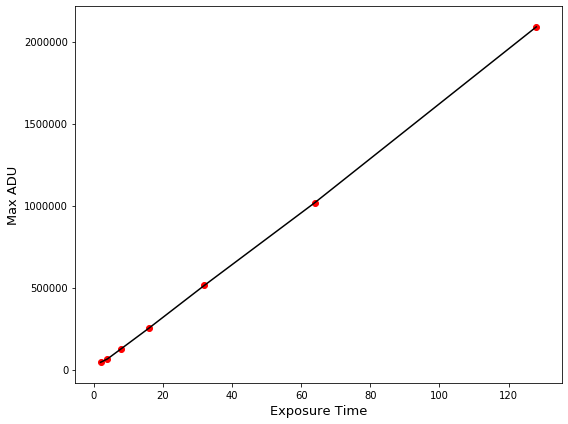

In [23]:
#CLD I'll be plotting the mean value for each frame versus the time that frame was taken
fig,ax = plt.subplots(figsize=(8,6))
ax.plot(time, max_adu, c='k');
ax.scatter(time, max_adu, c='r')
ax.set_xlabel('Exposure Time', fontsize=13)
ax.set_ylabel('Max ADU', fontsize=13)
fig.tight_layout()
plt.show(fig);

It does look as if the signal stays linear as it is pushed to its limits.

# Problem 3

I will again be looking at a085 for this problem. I will first use imexam to find the positions of the stars I need for apreture photometry in this frame. I will then preform photometry of apretures r=1-12. I do not know yet how to calculate the appropriate S/N.


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/carriedrake/Documents/Graduate School/obs_astro/imaging/reduced_data/a085otbf.fits
xc=991.5807	yc=900.4305
Background per pixel: 123.10642254768779
Max. pix. flux =   893.365
amp =   975.286
fwhm =     3.919


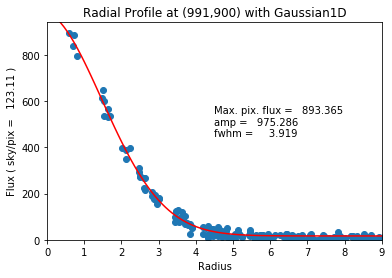

xc=1363.9824	yc=1230.9676
Background per pixel: 161.8751959690036
Max. pix. flux = 47159.361
amp = 48272.209
fwhm =     4.026


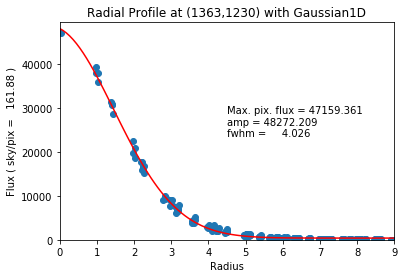

xc=1240.9227	yc=969.6445
Background per pixel: 122.06013527702838
Max. pix. flux =   941.311
amp =  1012.434
fwhm =     4.014


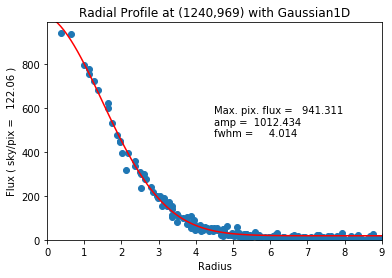

xc=1044.8044	yc=1043.2178
Background per pixel: 128.56584178095153
Max. pix. flux =  7126.969
amp =  7697.357
fwhm =     4.130


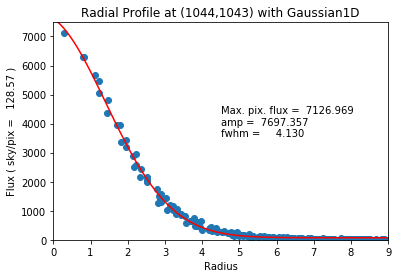

In [1017]:
viewer.imexam()

I will be using p=[1240,969] as my faint star, p=[1044,1043] as my medium star, and p=[1363,1230] as my bright star (I don't think its saturated although the max flux is pretty high).

In [1018]:
#CLD creating the aps of various r for all three stars
positions = [(1240,969), (1044,1043), (1363,1230)]
ap1 = CircularAperture(positions, r=1)
ap2 = CircularAperture(positions, r=2)
ap3 = CircularAperture(positions, r=3)
ap4 = CircularAperture(positions, r=4)
ap5 = CircularAperture(positions, r=5)
ap6 = CircularAperture(positions, r=6)
ap7 = CircularAperture(positions, r=7)
ap8 = CircularAperture(positions, r=8)
ap9 = CircularAperture(positions, r=9)
ap10 = CircularAperture(positions, r=10)
ap11 = CircularAperture(positions, r=11)
ap12 = CircularAperture(positions, r=12)

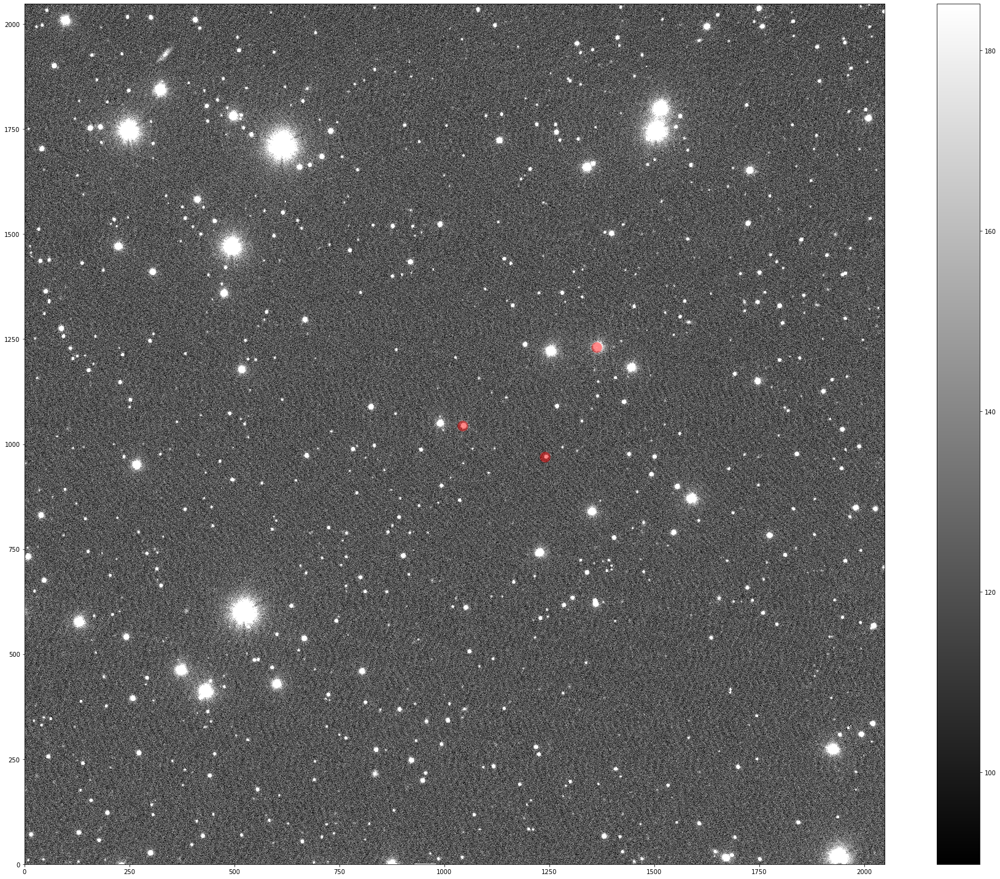

In [1043]:
#CLD plotting for visualization purposes
fig,ax = plt.subplots(figsize=(30,20))
show_image(a085, cmap='gray', ax=ax, fig=fig)
ap1.plot(color='r',lw=1.5, alpha=0.25);
ap2.plot(color='r',lw=1.5, alpha=0.25);
ap3.plot(color='r',lw=1.5, alpha=0.25);
ap4.plot(color='r',lw=1.5, alpha=0.25);
ap5.plot(color='r',lw=1.5, alpha=0.25);
ap6.plot(color='r',lw=1.5, alpha=0.25);
ap7.plot(color='r',lw=1.5, alpha=0.25);
ap8.plot(color='r',lw=1.5, alpha=0.25);
ap9.plot(color='r',lw=1.5, alpha=0.25);
ap10.plot(color='r',lw=1.5, alpha=0.25);
ap11.plot(color='r',lw=1.5, alpha=0.25);
ap12.plot(color='r',lw=1.5, alpha=0.25);
fig.tight_layout()

In [145]:
#CLD now preforming aperture photometry on all of the apertures
ap1_table = aperture_photometry(a085, ap1)
ap2_table = aperture_photometry(a085, ap2)
ap3_table = aperture_photometry(a085, ap3)
ap4_table = aperture_photometry(a085, ap4)
ap5_table = aperture_photometry(a085, ap5)
ap6_table = aperture_photometry(a085, ap6)
ap7_table = aperture_photometry(a085, ap7)
ap8_table = aperture_photometry(a085, ap8)
ap9_table = aperture_photometry(a085, ap9)
ap10_table = aperture_photometry(a085, ap10)
ap11_table = aperture_photometry(a085, ap11)
ap12_table = aperture_photometry(a085, ap12)

To get the S/N, need to first subtract the background counts from the source counts. To do this, multiply the area of the source with the counts/pix of the background, and subtract this number from the sum of counts in aps. This gets you $R_s$t. This solve for S/N using the background limited case from notes.

In [1028]:
#CLD for the background annulus I'll use a radius of 13 and 14 which should be fine because none of the stars I choose
#CLD look too too bad 
back_ann = CircularAnnulus(positions, r_in=22, r_out=26)

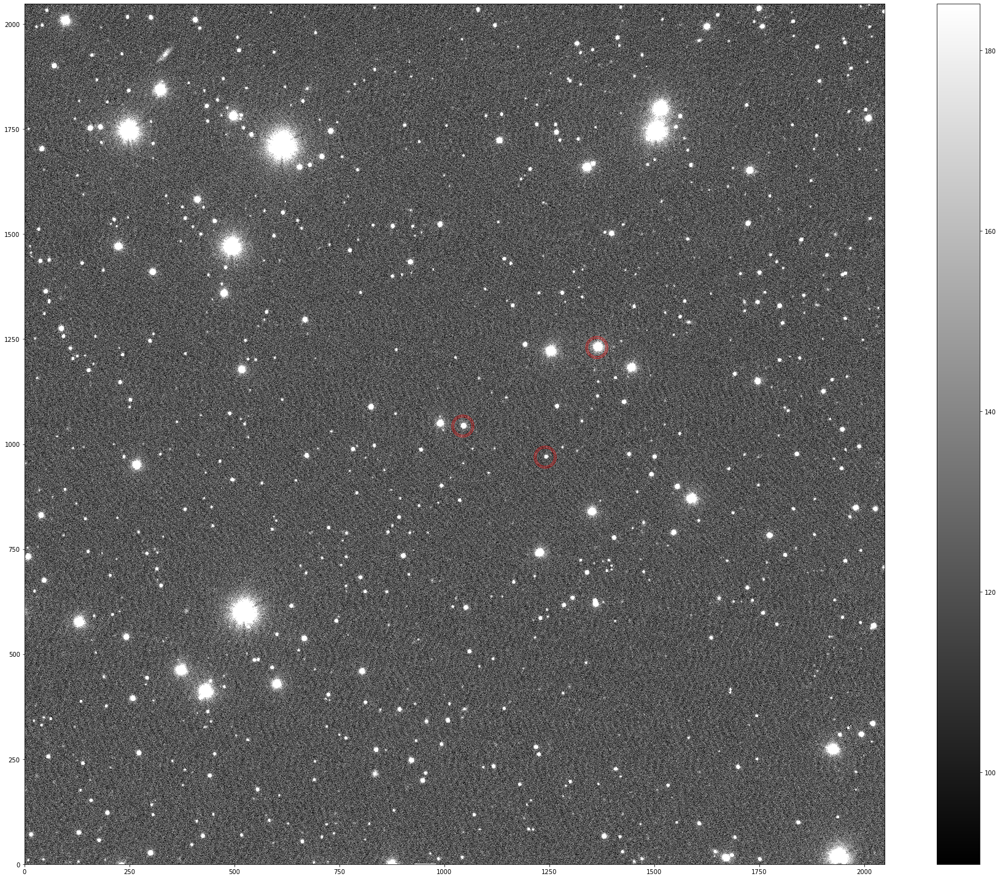

In [1044]:
#CLD plotting the background annuli so I know there's no other sources in it and that it is outside the star
fig,ax = plt.subplots(figsize=(30,20))
show_image(a085, cmap='gray', ax=ax, fig=fig)
back_ann.plot(color='r',lw=1.5, alpha=0.5)
fig.tight_layout();

In [1030]:
#CLD need the area of the back so can take app sum and 
area_back = back_ann.area
back_table = aperture_photometry(a085, back_ann)
back_count = back_table['aperture_sum']
back_rate = back_count / area_back

In [1031]:
#CLD multiplying the area of the sources by back_rate
ap1_rate = ap1_table['aperture_sum'] - ap1.area*(back_rate)
ap2_rate = ap2_table['aperture_sum'] - ap2.area*(back_rate)
ap3_rate = ap3_table['aperture_sum'] - ap3.area*(back_rate)
ap4_rate = ap4_table['aperture_sum'] - ap4.area*(back_rate)
ap5_rate = ap5_table['aperture_sum'] - ap5.area*(back_rate)
ap6_rate = ap6_table['aperture_sum'] - ap6.area*(back_rate)
ap7_rate = ap7_table['aperture_sum'] - ap7.area*(back_rate)
ap8_rate = ap8_table['aperture_sum'] - ap8.area*(back_rate)
ap9_rate = ap9_table['aperture_sum'] - ap9.area*(back_rate)
ap10_rate = ap10_table['aperture_sum'] - ap10.area*(back_rate)
ap11_rate = ap11_table['aperture_sum'] - ap11.area*(back_rate)
ap12_rate = ap12_table['aperture_sum'] - ap12.area*(back_rate)

In [1038]:
#CLD background limited S/N = Rst / sqrt(Rst + pix*(Rbt+Nr**2))
#CLD Rst is the rates above
#CLD pix*Rbt is the back count 
#CLD Nr is the read noise from WIRO
ap1_sn = ap1_rate / np.sqrt(ap1_rate + ap1.area*(back_count + 4.5**2))
ap2_sn = ap2_rate / np.sqrt(ap2_rate + ap2.area*(back_count + 4.5**2))
ap3_sn = ap3_rate / np.sqrt(ap3_rate + ap3.area*(back_count + 4.5**2))
ap4_sn = ap4_rate / np.sqrt(ap4_rate + ap4.area*(back_count + 4.5**2))
ap5_sn = ap5_rate / np.sqrt(ap5_rate + ap5.area*(back_count + 4.5**2))
ap6_sn = ap6_rate / np.sqrt(ap6_rate + ap6.area*(back_count + 4.5**2))
ap7_sn = ap7_rate / np.sqrt(ap7_rate + ap7.area*(back_count + 4.5**2))
ap8_sn = ap8_rate / np.sqrt(ap8_rate + ap8.area*(back_count + 4.5**2))
ap9_sn = ap9_rate / np.sqrt(ap9_rate + ap9.area*(back_count + 4.5**2))
ap10_sn = ap10_rate / np.sqrt(ap10_rate + ap10.area*(back_count + 4.5**2))
ap11_sn = ap11_rate / np.sqrt(ap11_rate + ap11.area*(back_count + 4.5**2))
ap12_sn = ap12_rate / np.sqrt(ap12_rate + ap12.area*(back_count + 4.5**2))

ap_sns = np.array([ap1_sn, ap2_sn, ap3_sn, ap4_sn, ap5_sn, ap6_sn, ap7_sn, ap8_sn, ap9_sn, ap10_sn, ap11_sn, ap12_sn])

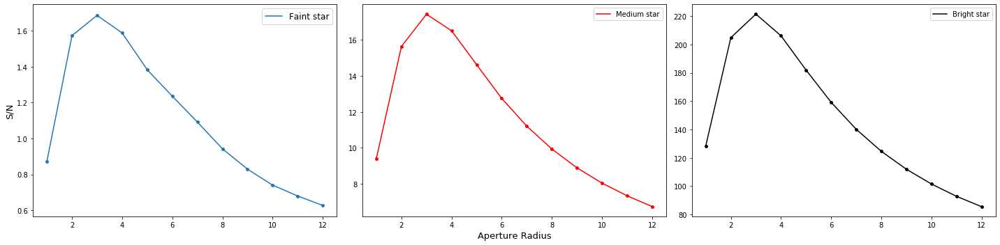

In [1042]:
radii = [1,2,3,4,5,6,7,8,9,10,11,12]

#CLD plotting S/N vs aperture size curves
fig,ax = plt.subplots(1,3,figsize=(20,5))
ax[0].scatter(radii, ap_sns[:,0], s=15)
ax[0].plot(radii, ap_sns[:,0], label='Faint star')
ax[1].scatter(radii, ap_sns[:,1], s=15, c='r')
ax[1].plot(radii, ap_sns[:,1], c='r', label='Medium star')
ax[2].scatter(radii, ap_sns[:,2], s=15, c='k')
ax[2].plot(radii, ap_sns[:,2], c='k', label='Bright star')
ax[1].set_xlabel('Aperture Radius', fontsize=13)
ax[0].set_ylabel('S/N', fontsize=13)
ax[0].legend(fontsize=12)
ax[1].legend()
ax[2].legend()
fig.tight_layout()
plt.show(fig)

These plots all bear a striking resemablance to the plots seen in fig 5.7 of Howell. From these plots, it is clear that a FWHM of about 4 for this airmass captures the optimal S/N raito.

# Problem 4

Based on Landolt (1992), there are six standard stars in PG1633+099. I will use imexam to get the positions of the stars in a085 and plot an annulus around them. This should help me identify them for the rest of the frames.


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/carriedrake/Documents/Graduate School/obs_astro/imaging/reduced_data/a085otbf.fits
xc=1251.6690	yc=1221.4301
Background per pixel: 173.62091172442186
Max. pix. flux = 55993.090
amp = 65923.128
fwhm =     4.221


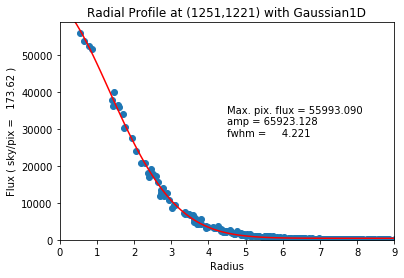

xc=1363.9824	yc=1230.9676
Background per pixel: 161.87519089668393
Max. pix. flux = 47159.361
amp = 48272.210
fwhm =     4.026


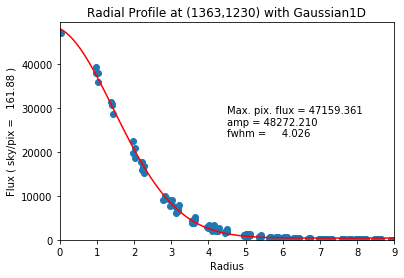

xc=1444.0143	yc=1182.0363
Background per pixel: 150.46000147387957
Max. pix. flux = 30823.501
amp = 31492.575
fwhm =     4.073


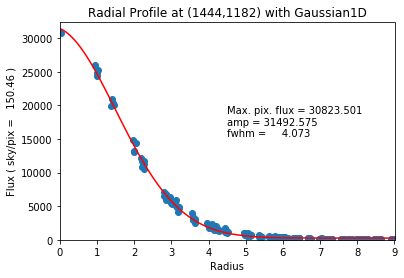

xc=988.8694	yc=1049.2816
Background per pixel: 138.06395794740064
Max. pix. flux = 16768.030
amp = 18571.391
fwhm =     4.243


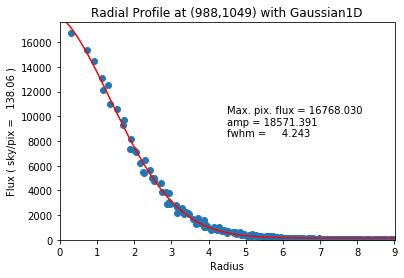

xc=1044.8044	yc=1043.2178
Background per pixel: 128.56585931911806
Max. pix. flux =  7126.969
amp =  7697.357
fwhm =     4.130


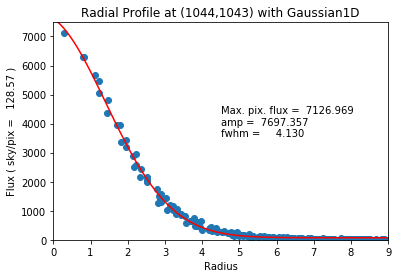

In [137]:
viewer.imexam()

In [141]:
standard_pos = [(1251, 1221), (1363,1230), (1444, 1182), (988,1049), (1044,1043)]
stand_aps = CircularAperture(standard_pos, r=30) #CLD making apertures to demonstrate the stars I choose

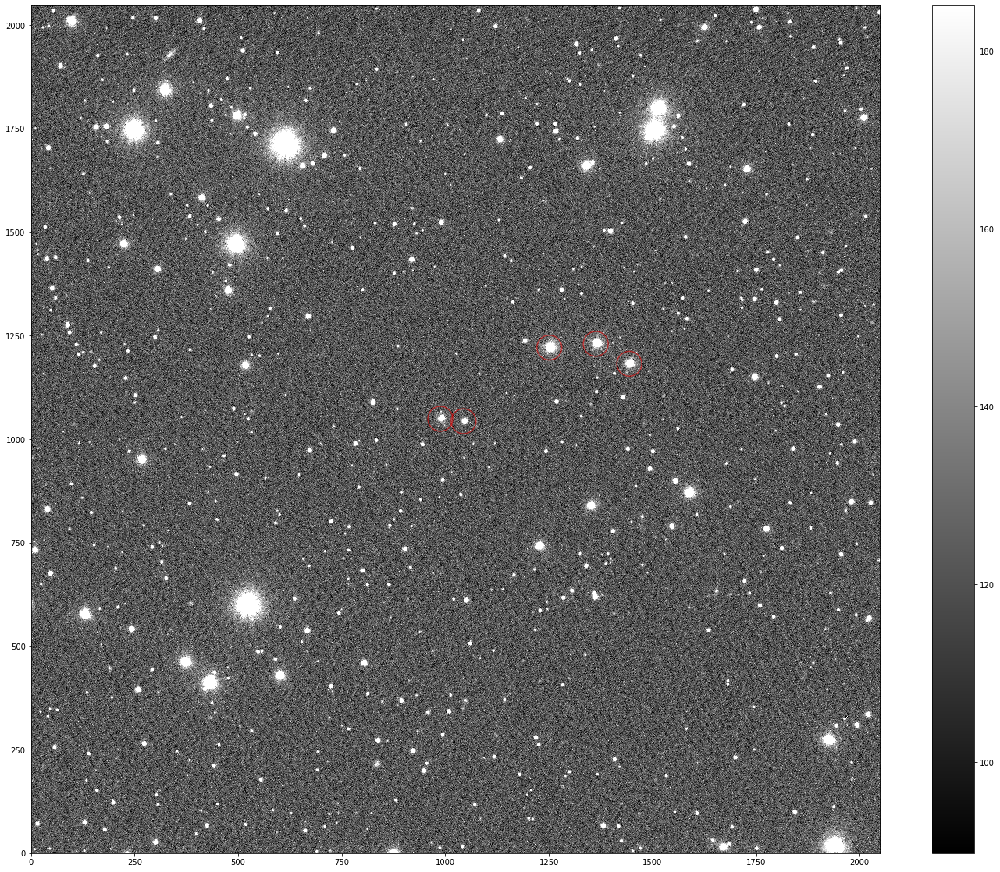

In [151]:
fig,ax = plt.subplots(figsize=(30,20))
show_image(a085, cmap='gray', ax=ax, fig=fig)
stand_aps.plot(color='r',lw=1.5, alpha=0.5);

# Problem 5

To extract instrumental magnitudes, I will use a FWHM=4, as that is the best aperture size gathered from above, and threshold=5 * the standard deviation of that frame, while also subtracting the median value of that frame from the data to find sources. The last two steps is what is recommended in the photutils documentation. Then I will go in and visually identify the centeral positions of standard stars in each batch of frames, which will create a range of centers I can mask my source list to in order to just extract the standard stars.

Note: My first star is leftmost star in the three, second is middle of three, third is rightmost of three, fourth is leftmost of two, and fifth (last star) is the rightmost of the pair.

In [442]:
source_list1 = []
for i in range((92-81)+1):
    data = fits.getdata(path_data+'a0'+str(i+81)+'otbf.fits')
    mean, median, std = sigma_clipped_stats(data, sigma=3.0) 
    daofind = DAOStarFinder(fwhm=4.0, threshold=5.*std)
    sources = daofind(data-median)
    for col in sources.colnames:  
        sources[col].info.format = '%.8g'
    source_list1.append(sources)
    
source_list1 = np.array(source_list1)

In [443]:
source_list2 = []
for i in range((139-130)+1):
    data = fits.getdata(path_data+'a'+str(i+130)+'otbf.fits')
    mean, median, std = sigma_clipped_stats(data, sigma=3.0) 
    daofind = DAOStarFinder(fwhm=4.0, threshold=5.*std)
    sources = daofind(data-median)
    for col in sources.colnames:  
        sources[col].info.format = '%.8g'
    source_list2.append(sources)
    
source_list2 = np.array(source_list2)

In [444]:
source_list3 = []
for i in range((211-202)+1):
    data = fits.getdata(path_data+'a'+str(i+202)+'otbf.fits')
    mean, median, std = sigma_clipped_stats(data, sigma=3.0) 
    daofind = DAOStarFinder(fwhm=4.0, threshold=5.*std)
    sources = daofind(data-median)
    for col in sources.colnames:  
        sources[col].info.format = '%.8g'
    source_list3.append(sources)
    
source_list3 = np.array(source_list3)

In [445]:
source_list4 = []
for i in range((246-237)+1):
    data = fits.getdata(path_data+'a'+str(i+237)+'otbf.fits')
    mean, median, std = sigma_clipped_stats(data, sigma=3.0) 
    daofind = DAOStarFinder(fwhm=5.0, threshold=5.*std) #CLD needed to increase the FWHM for airmass reasons?
    sources = daofind(data-median)
    for col in sources.colnames:  
        sources[col].info.format = '%.8g'
    source_list4.append(sources)
    
source_list4 = np.array(source_list4)

To find the standard stars in each of the set of images, I will be creating an a np.where mask for each of the stars. I will be using implementing a range of xcentroid and y centroid values that are acceptable in order to find the stars in the source list table. This position of xcentroid and ycentroid is found using visual inspection from an image in this source list frame set. I will then use each mask to append the mag to a list of each sources mags.

In [662]:
#CLD finding the standard stars in 81
s1_mags = []
for i in range(len(source_list1)):
    s1 = np.where(((source_list1[i]['xcentroid']>1254-8) & (source_list1[i]['xcentroid']<1254+8))
                  & ((source_list1[i]['ycentroid']>1222-8) & (source_list1[i]['ycentroid']<1222+8)))
    s1_mags.append(source_list1[i][s1]['mag'][0])

In [663]:
s2_mags = []
for i in range(len(source_list1)):
    s2 = np.where(((source_list1[i]['xcentroid']>1360-8) & (source_list1[i]['xcentroid']<1360+8))
                  & ((source_list1[i]['ycentroid']>1234-8) & (source_list1[i]['ycentroid']<1234+8)))
    s2_mags.append(source_list1[i][s2]['mag'][0])

In [664]:
s3_mags = []
for i in range(len(source_list1)):
    s3 = np.where(((source_list1[i]['xcentroid']>1443-8) & (source_list1[i]['xcentroid']<1443+8))
                  & ((source_list1[i]['ycentroid']>1184-8) & (source_list1[i]['ycentroid']<1184+8)))
    s3_mags.append(source_list1[i][s3]['mag'][0])

In [665]:
s4_mags = []
for i in range(len(source_list1)):
    s4 = np.where(((source_list1[i]['xcentroid']>987-8) & (source_list1[i]['xcentroid']<987+8))
                  & ((source_list1[i]['ycentroid']>1051-8) & (source_list1[i]['ycentroid']<1051+8)))
    s4_mags.append(source_list1[i][s4]['mag'][0])

In [666]:
s5_mags = []
for i in range(len(source_list1)):
    s5 = np.where(((source_list1[i]['xcentroid']>1042-8) & (source_list1[i]['xcentroid']<1042+8))
                  & ((source_list1[i]['ycentroid']>1045-8) & (source_list1[i]['ycentroid']<1045+8)))
    s5_mags.append(source_list1[i][s5]['mag'][0])

Repeating the above, but for the images taken at different times.

In [667]:
for i in range(len(source_list2)):
    s1 = np.where(((source_list2[i]['xcentroid']>1196-8) & (source_list2[i]['xcentroid']<1196+8))
                  & ((source_list2[i]['ycentroid']>1215-8) & (source_list2[i]['ycentroid']<1215+8)))
    s1_mags.append(source_list2[i][s1]['mag'][0])
    
    s2 = np.where(((source_list2[i]['xcentroid']>1309-8) & (source_list2[i]['xcentroid']<1309+8))
                  & ((source_list2[i]['ycentroid']>1226-8) & (source_list2[i]['ycentroid']<1226+8)))
    s2_mags.append(source_list2[i][s2]['mag'][0])
    
    s3 = np.where(((source_list2[i]['xcentroid']>1390-8) & (source_list2[i]['xcentroid']<1390+8))
                  & ((source_list2[i]['ycentroid']>1177-8) & (source_list2[i]['ycentroid']<1177+8)))
    s3_mags.append(source_list2[i][s3]['mag'][0])
    
    s4 = np.where(((source_list2[i]['xcentroid']>933-8) & (source_list2[i]['xcentroid']<933+8))
                  & ((source_list2[i]['ycentroid']>1044-8) & (source_list2[i]['ycentroid']<1044+8)))
    s4_mags.append(source_list2[i][s4]['mag'][0])
    
    s5 = np.where(((source_list2[i]['xcentroid']>988-8) & (source_list2[i]['xcentroid']<988+8))
                  & ((source_list2[i]['ycentroid']>1038-8) & (source_list2[i]['ycentroid']<1038+8)))
    s5_mags.append(source_list2[i][s5]['mag'][0])

In [668]:
for i in range(len(source_list3)):
    s1 = np.where(((source_list3[i]['xcentroid']>1189-5) & (source_list3[i]['xcentroid']<1189+5))
                  & ((source_list3[i]['ycentroid']>1209-5) & (source_list3[i]['ycentroid']<1209+5)))
    s1_mags.append(source_list3[i][s1]['mag'][0])
    
    s2 = np.where(((source_list3[i]['xcentroid']>1301-5) & (source_list3[i]['xcentroid']<1301+5))
                  & ((source_list3[i]['ycentroid']>1219-5) & (source_list3[i]['ycentroid']<1219+5)))
    s2_mags.append(source_list3[i][s2]['mag'][0])
    
    s3 = np.where(((source_list3[i]['xcentroid']>1380-5) & (source_list3[i]['xcentroid']<1380+5))
                  & ((source_list3[i]['ycentroid']>1168-5) & (source_list3[i]['ycentroid']<1168+5)))
    s3_mags.append(source_list3[i][s3]['mag'][0])
    
    s4 = np.where(((source_list3[i]['xcentroid']>926-5) & (source_list3[i]['xcentroid']<926+5))
                  & ((source_list3[i]['ycentroid']>1037-5) & (source_list3[i]['ycentroid']<1037+5)))
    s4_mags.append(source_list3[i][s4]['mag'][0])
    
    s5 = np.where(((source_list3[i]['xcentroid']>981-5) & (source_list3[i]['xcentroid']<981+5))
                  & ((source_list3[i]['ycentroid']>1032-5) & (source_list3[i]['ycentroid']<1032+5)))
    s5_mags.append(source_list3[i][s5]['mag'][0])

In [538]:
#for i in range(len(source_list4)):
    #s1 = np.where(((source_list4[i]['xcentroid']>1102-5) & (source_list4[i]['xcentroid']<1102+5))
                  #& ((source_list4[i]['ycentroid']>1211-5) & (source_list4[i]['ycentroid']<1211+5)))
    #s1_mags.append(source_list4[i][s1]['mag'][0])
    
    #s2 = np.where(((source_list4[i]['xcentroid']>1213-5) & (source_list4[i]['xcentroid']<1213+5))
                  #& ((source_list4[i]['ycentroid']>1220-5) & (source_list4[i]['ycentroid']<1220+5)))
    #s2_mags.append(source_list4[i][s2]['mag'][0])
    
    #s3 = np.where(((source_list4[i]['xcentroid']>1295-5) & (source_list4[i]['xcentroid']<1295+5))
                  #& ((source_list4[i]['ycentroid']>1174-5) & (source_list4[i]['ycentroid']<1174+5)))
    #s3_mags.append(source_list4[i][s3]['mag'][0])
    
    #s4 = np.where(((source_list4[i]['xcentroid']>840-5) & (source_list4[i]['xcentroid']<840+5))
                  #& ((source_list4[i]['ycentroid']>1041-5) & (source_list4[i]['ycentroid']<1041+5)))
    #s4_mags.append(source_list4[i][s4]['mag'][0])
    
    #s5 = np.where(((source_list4[i]['xcentroid']>895-5) & (source_list4[i]['xcentroid']<895+5))
                  #& ((source_list4[i]['ycentroid']>1035-5) & (source_list4[i]['ycentroid']<1035+5)))
    #s5_mags.append(source_list4[i][s5]['mag'][0])
    
    
#CLD currently I am working without these frames as they were really dragging down my K values later in the notebook.
#CLD additionally, I trust my detection using photutils the least with these frames
#CLD might add them in again at a later date

Now, I am going to make a list of mags for each individual star bc I think it will make the future plotting/math a bit easier.

In [670]:
print(len(source_list1))
print(len(source_list2))
print(len(source_list3))
s1_mags = np.asarray(s1_mags).flatten()
s2_mags = np.array(s2_mags).flatten()
s3_mags = np.array(s3_mags).flatten()
s4_mags = np.array(s4_mags).flatten()
s5_mags = np.array(s5_mags).flatten()

12
10
10


Ok, so the order that the images were taken in follow a pattern when considering the filters. The first two are always U, the next two are always B, and so on. Using this logic, and the length of the arrays, I can deduce the index for all of the mags for a specific filter from the master list to make a mask for each filter. Additionally, skipping over the two H-alpha filter ones in source_list1 as we don't need to worry about those.

Additionally, these masks can be applied to each each star's mag list for convience.

In [671]:
u_mask = [0,1,12,13,22,23] #CLD u mag is the first two of every source list array
b_mask = [2,3,14,15,24,25]
v_mask = [4,5,16,17,26,27]
r_mask = [6,7,18,19,28,29]
i_mask = [8,9,20,21,30,31] #CLD 

s1_u = s1_mags[u_mask]
s2_u = s2_mags[u_mask]
s3_u = s3_mags[u_mask]
s4_u = s4_mags[u_mask]
s5_u = s5_mags[u_mask]

s1_b = s1_mags[b_mask]
s2_b = s2_mags[b_mask]
s3_b = s3_mags[b_mask]
s4_b = s3_mags[b_mask]
s5_b = s3_mags[b_mask]

s1_v = s1_mags[v_mask]
s2_v = s2_mags[v_mask]
s3_v = s3_mags[v_mask]
s4_v = s4_mags[v_mask]
s5_v = s5_mags[v_mask]

s1_r = s1_mags[r_mask]
s2_r = s2_mags[r_mask]
s3_r = s3_mags[r_mask]
s4_r = s4_mags[r_mask]
s5_r = s5_mags[r_mask]

s1_i = s1_mags[i_mask]
s2_i = s2_mags[i_mask]
s3_i = s3_mags[i_mask]
s4_i = s4_mags[i_mask]
s5_i = s5_mags[i_mask]

# Problem 6

For this problem, I first need the given magnitudes from Landolt for each star.

In [672]:
#CLD denoting source number as the order they appear in the table in Landlot
#CLD V mags are given
vs1 = 14.397
vs2 = 15.256
vs3 = 12.969
vs4 = 13.229
vs5 = 13.691

#CLD B-V is given, so solving for B
bs1 = vs1 - 0.192
bs2 = vs2 + 0.873
bs3 = vs3 + 1.081
bs4 = vs4 + 1.134
bs5 = vs5 + 0.535

#CLD U-B is given so solving for U
us1 = bs1 - 0.974
us2 = bs2 + 0.320
us3 = bs3 + 1.007
us4 = bs4 + 1.138
us5 = bs5 - 0.025

#CLD V-R is given so solving for R
rs1 = -(-vs1-0.093)
rs2 = -(-vs2+0.505)
rs3 = -(-vs3+0.590)
rs4 = -(-vs4+0.618)
rs5 = -(-vs5+0.324)

#CLD R-I is given so solving for I
is1 = -(-rs1-0.116)
is2 = -(-rs2+0.511)
is3 = -(-rs3+0.502)
is4 = -(-rs4+0.523)
is5 = -(-rs5+0.327)

#CLD arrays will be arranged as UBVRI
#CLD my source 1 is B so s3 in the paper
#CLD my source 2 is C so s4
#CLD my source 3 is D so s5
#CLD my source 4 is 1 so s1
#CLD my source 5 is A so s2
s1_land = np.array([us3, bs3, vs3, rs3, is3])
s2_land = np.array([us4, bs4, vs4, rs4, is4])
s3_land = np.array([us5, bs5, vs5, rs5, is5])
s4_land = np.array([us1, bs1, vs1, rs1, is1])
s5_land = np.array([us2, bs2, vs2, rs2, is2])

In [601]:
#CLD making an array of the airmasses for each filter
airmasses_u = np.array([1.18,1.18,1.23,1.23,1.49,1.49])
airmasses_b = np.array([1.18,1.18,1.24,1.24,1.51,1.51])
airmasses_v = np.array([1.18,1.18,1.24,1.24,1.52,1.52])
airmasses_r = np.array([1.18,1.18,1.24,1.24,1.53,1.53])
airmasses_i = np.array([1.18,1.17,1.24,1.24,1.53,1.53])

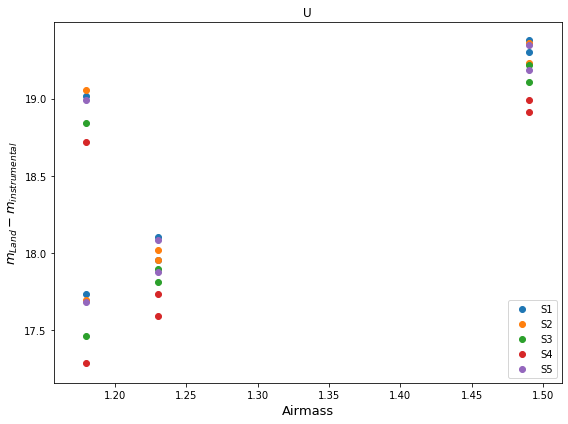

In [673]:
#CLD plotting the difference between the accpeted mag and my instrumental mag vs airmass
fig,ax = plt.subplots(figsize=(8,6))
ax.scatter(airmasses_u, -s1_u+s1_land[0], label='S1')
ax.scatter(airmasses_u, -s2_u+s2_land[0], label="S2")
ax.scatter(airmasses_u, -s3_u+s3_land[0], label="S3")
ax.scatter(airmasses_u, -s4_u+s4_land[0], label='S4')
ax.scatter(airmasses_u, -s5_u+s5_land[0], label='S5')
ax.set_title('U', fontsize=12)
ax.set_ylabel(r'$m_{Land} - m_{instrumental}$', fontsize=13)
ax.set_xlabel('Airmass', fontsize=13)
ax.legend()
fig.tight_layout()
plt.show(fig)

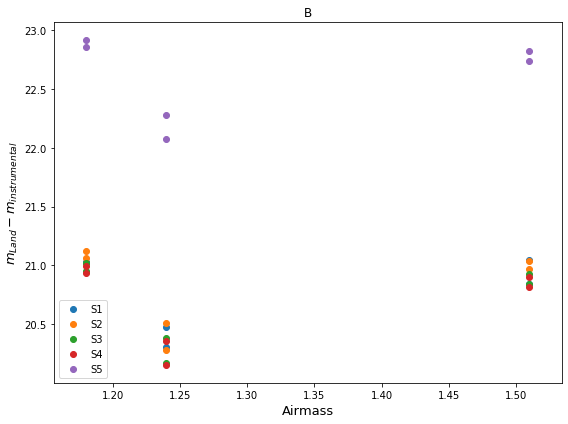

In [674]:
#CLD plotting the difference between the accpeted mag and my instrumental mag vs airmass
fig,ax = plt.subplots(figsize=(8,6))
ax.scatter(airmasses_b, -s1_b+s1_land[1], label='S1')
ax.scatter(airmasses_b, -s2_b+s2_land[1], label="S2")
ax.scatter(airmasses_b, -s3_b+s3_land[1], label="S3")
ax.scatter(airmasses_b, -s4_b+s4_land[1], label='S4')
ax.scatter(airmasses_b, -s5_b+s5_land[1], label='S5')
ax.set_title('B', fontsize=12)
ax.set_ylabel(r'$m_{Land} - m_{instrumental}$', fontsize=13)
ax.set_xlabel('Airmass', fontsize=13)
ax.legend()
fig.tight_layout()
plt.show(fig)

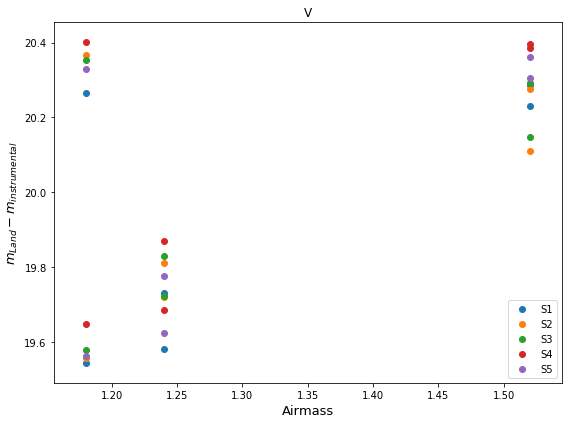

In [675]:
#CLD plotting the difference between the accpeted mag and my instrumental mag vs airmass
fig,ax = plt.subplots(figsize=(8,6))
ax.scatter(airmasses_v, -s1_v+s1_land[2], label='S1')
ax.scatter(airmasses_v, -s2_v+s2_land[2], label="S2")
ax.scatter(airmasses_v, -s3_v+s3_land[2], label="S3")
ax.scatter(airmasses_v, -s4_v+s4_land[2], label='S4')
ax.scatter(airmasses_v, -s5_v+s5_land[2], label='S5')
ax.set_title('V', fontsize=12)
ax.set_ylabel(r'$m_{Land} - m_{instrumental}$', fontsize=13)
ax.set_xlabel('Airmass', fontsize=13)
ax.legend()
fig.tight_layout()
plt.show(fig)

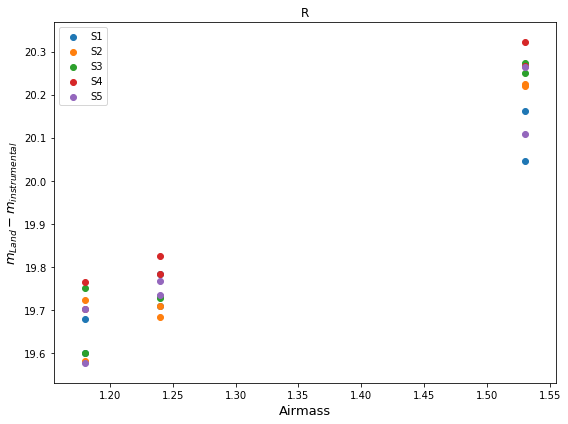

In [676]:
#CLD plotting the difference between the accpeted mag and my instrumental mag vs airmass
fig,ax = plt.subplots(figsize=(8,6))
ax.scatter(airmasses_r, -s1_r+s1_land[3], label='S1')
ax.scatter(airmasses_r, -s2_r+s2_land[3], label="S2")
ax.scatter(airmasses_r, -s3_r+s3_land[3], label="S3")
ax.scatter(airmasses_r, -s4_r+s4_land[3], label='S4')
ax.scatter(airmasses_r, -s5_r+s5_land[3], label='S5')
ax.set_title('R', fontsize=12)
ax.set_ylabel(r'$m_{Land} - m_{instrumental}$', fontsize=13)
ax.set_xlabel('Airmass', fontsize=13)
ax.legend()
fig.tight_layout()
plt.show(fig)

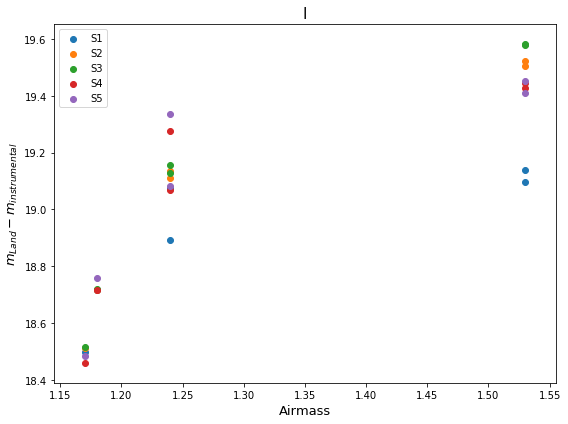

In [677]:
#CLD plotting the difference between the accpeted mag and my instrumental mag vs airmass
fig,ax = plt.subplots(figsize=(8,6))
ax.scatter(airmasses_i, -s1_i+s1_land[4], label='S1')
ax.scatter(airmasses_i, -s2_i+s2_land[4], label="S2")
ax.scatter(airmasses_i, -s3_i+s3_land[4], label="S3")
ax.scatter(airmasses_i, -s4_i+s4_land[4], label='S4')
ax.scatter(airmasses_i, -s5_i+s5_land[4], label='S5')
ax.set_title('I', fontsize=15)
ax.set_ylabel(r'$m_{Land} - m_{instrumental}$', fontsize=13)
ax.set_xlabel('Airmass', fontsize=13)
ax.legend()
fig.tight_layout()
plt.show(fig)

In [678]:
#CLD using the linear regression model from sci kit learn which does lsqr fitting
model = LinearRegression(fit_intercept=True)

In [679]:
c1u = model.fit(airmasses_u[:,None], s1_land[0]-s1_u).coef_
c2u = model.fit(airmasses_u[:,None], s2_land[0]-s2_u).coef_
c3u = model.fit(airmasses_u[:,None], s3_land[0]-s3_u).coef_
c4u = model.fit(airmasses_u[:,None], s4_land[0]-s4_u).coef_
c5u = model.fit(airmasses_u[:,None], s5_land[0]-s5_u).coef_
c = np.array([c1u,c2u,c3u,c4u,c5u])
k_u = np.mean(c)
print(np.mean(c))

3.7127356614364238


In [680]:
c1b = model.fit(airmasses_b[:,None], s1_land[1]-s1_b).coef_
c2b = model.fit(airmasses_b[:,None], s2_land[1]-s2_b).coef_
c3b = model.fit(airmasses_b[:,None], s3_land[1]-s3_b).coef_
c4b = model.fit(airmasses_b[:,None], s4_land[1]-s4_b).coef_
c5b = model.fit(airmasses_b[:,None], s5_land[1]-s5_b).coef_
c = np.array([c1b,c2b,c3b,c4b,c5b])
k_b = np.mean(c)
print(np.mean(c))

0.472047721487578


In [681]:
c1v = model.fit(airmasses_v[:,None], s1_land[2]-s1_v).coef_
c2v = model.fit(airmasses_v[:,None], s2_land[2]-s2_v).coef_
c3v = model.fit(airmasses_v[:,None], s3_land[2]-s3_v).coef_
c4v = model.fit(airmasses_v[:,None], s4_land[2]-s4_v).coef_
c5v = model.fit(airmasses_v[:,None], s5_land[2]-s5_v).coef_
c = np.array([c1v,c2v,c3v,c4v,c5v])
k_v = np.mean(c)
print(np.mean(c))

1.2497376496293857


In [682]:
c1r = model.fit(airmasses_r[:,None], s1_land[3]-s1_r).coef_
c2r = model.fit(airmasses_r[:,None], s2_land[3]-s2_r).coef_
c3r = model.fit(airmasses_r[:,None], s3_land[3]-s3_r).coef_
c4r = model.fit(airmasses_r[:,None], s4_land[3]-s4_r).coef_
c5r = model.fit(airmasses_r[:,None], s5_land[3]-s5_r).coef_
c = np.array([c1r,c2r,c3r,c4r,c5r])
k_r = np.mean(c)
print(np.mean(c))

1.5763643288528246


In [683]:
c1i = model.fit(airmasses_i[:,None], s1_land[4]-s1_i).coef_
c2i = model.fit(airmasses_i[:,None], s2_land[4]-s2_i).coef_
c3i = model.fit(airmasses_i[:,None], s3_land[4]-s3_i).coef_
c4i = model.fit(airmasses_i[:,None], s4_land[4]-s4_i).coef_
c5i = model.fit(airmasses_i[:,None], s5_land[4]-s5_i).coef_
c = np.array([c1i,c2i,c3i,c4i,c5i])
k_i = np.mean(c)
print(np.mean(c))

1.891754088313202


Ok, so B is almost perfect, but the others are all very very wrong. I decided to take an average from each star, as they should all be effected by atmospheric extinction in the same way.

# Problem 7

To extinction correct, I'm going to be using my found k values, although I know that they are wrong. To extinction correct, simply subtract (k * X) from your instrumental mag.

In [684]:
#CLD U
s1_u = s1_u - c1u*airmasses_u
s2_u = s2_u - c2u*airmasses_u
s3_u = s3_u - c3u*airmasses_u
s4_u = s4_u - c4u*airmasses_u
s5_u = s5_u - c5u*airmasses_u

#CLD B
s1_b = s1_b - c1b*airmasses_b
s2_b = s2_b - c2b*airmasses_b
s3_b = s3_b - c3b*airmasses_b
s4_b = s4_b - c4b*airmasses_b
s5_b = s5_b - c5b*airmasses_b

#CLD V
s1_v = s1_v - c1v*airmasses_v
s2_v = s2_v - c2v*airmasses_v
s3_v = s3_v - c3v*airmasses_v
s4_v = s4_v - c4v*airmasses_v
s5_v = s5_v - c5v*airmasses_v

#CLD R
s1_r = s1_r - c1r*airmasses_r
s2_r = s2_r - c2r*airmasses_r
s3_r = s3_r - c3r*airmasses_r
s4_r = s4_r - c4r*airmasses_r
s5_r = s5_r - c5r*airmasses_r

#CLD I
s1_i = s1_r - c1i*airmasses_i
s2_i = s2_r - c2i*airmasses_i
s3_i = s3_r - c3i*airmasses_i
s4_i = s4_r - c4i*airmasses_i
s5_i = s5_r - c5i*airmasses_i

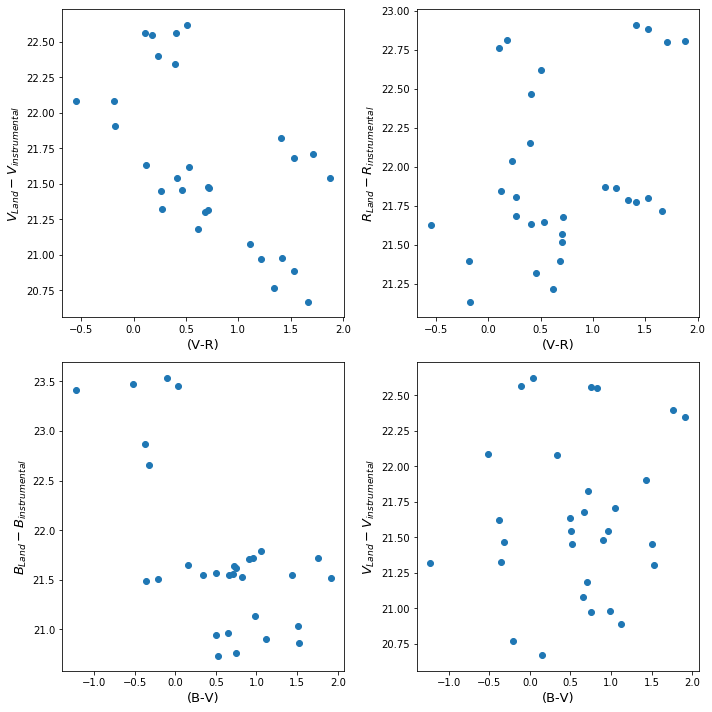

In [685]:
#CLD plotting the colors for all of the stars vs the differences in accepted mag and instrumental extinction corrected
#CLD mags

#CLD making arrays of the b,v,r instrumental mags so they're easier to plot
vs = np.array([s1_v, s2_v, s3_v, s4_v, s5_v]).flatten()
rs = np.array([s1_r, s2_r, s3_r, s4_r, s5_r]).flatten()
bs = np.array([s1_b, s2_b, s3_b, s4_b, s5_b]).flatten()


#CLD making arrays of the b,v,r landlot mags so they're easier to do math with
diff_v = np.array([-s1_v + s1_land[2], -s2_v + s2_land[2], -s3_v + s3_land[2], -s4_v + s4_land[2], 
                   -s5_v + s5_land[2]]).flatten()
diff_r = np.array([-s1_r + s1_land[3], -s2_r + s2_land[3], -s3_r + s3_land[3], -s4_r + s4_land[3], 
                   -s5_r + s5_land[3]]).flatten()
diff_b = np.array([-s1_b + s1_land[1], -s2_b + s2_land[1], -s3_b + s3_land[1], -s4_b + s4_land[1], 
                   -s5_b + s5_land[1]]).flatten()

fig,ax = plt.subplots(2,2,figsize=(10,10))
ax[0,0].scatter(vs-rs, diff_v)
ax[0,1].scatter(vs-rs, diff_r)
ax[1,0].scatter(bs-vs, diff_b)
ax[1,1].scatter(bs-vs, diff_v)
ax[0,0].set_xlabel('(V-R)', fontsize=13)
ax[0,1].set_xlabel('(V-R)', fontsize=13)
ax[1,0].set_xlabel('(B-V)', fontsize=13)
ax[1,1].set_xlabel('(B-V)', fontsize=13)
ax[0,0].set_ylabel(r'$V_{Land} - V_{instrumental}$', fontsize=13)
ax[0,1].set_ylabel(r'$R_{Land} - R_{instrumental}$', fontsize=13)
ax[1,0].set_ylabel(r'$B_{Land} - B_{instrumental}$', fontsize=13)
ax[1,1].set_ylabel(r'$V_{Land} - V_{instrumental}$', fontsize=13)
fig.tight_layout()
plt.show(fig)

I will not be using the bottom right panel as it looks the worst and is not needed as I can get the zero point for V from the v-r data.

In [698]:
#CLD fitting for yintercept and for the slope on the first color term
v_m, v_0 = np.polyfit((vs-rs), diff_v, deg=1)
b_m, b_0 = np.polyfit((bs-vs), diff_b, deg=1)
r_m, r_0 = np.polyfit((vs-rs), diff_r, deg=1)

In [704]:
#CLD just want to check how wrong i am
s1_v_stand = s1_v + v_0 + (v_m *(s1_b-s1_v))
s3_v_stand = s3_v + v_0 + (v_m*(s3_b-s3_v))

In [705]:
print(np.mean(s1_v_stand))
print(np.mean(s3_v_stand))

12.446707778430266
14.111491856654096


Ok, so my answer is a little wrong, but surprisingly close based on how wrong my data seems to be generally. Personally, pleasantly surprised!!

# Problem 8

For this problem, I am going to use two images taken in B and V as I already have the color corrections for those filters calculated. I might be able to do a coadd of the two images in each filter that are given to me, but I feel that, for the scope of this homework, unless it looks terrible otherwise, this is unnecessary, especially as combining images was not talked about in class.

To get the mags for the stars in NGC6823, I will first use imexam to investigate the proper FWHM I should pass to DAOstarfinder. I am fairly certain, from part one, that it will be about four, but doing a check is never harmful. I will then use DAOstarfinder to find all of the sources in the two images I choose to look at. This will provide the instrumental mags for all of the stars in this cluster, plus additional background/foreground stars. For the moment, I see no easy way to deal with those, other than creating a mask that covers the general extent in the image of the cluster, but at first I will just see how the CMD turns out without that precaution. Theoretically, all of the stars from the cluster should lie in defined HC curve with interloper stars providing dispersion/will clearly not be a part of the system. If this is not true, I will try the mask method. I will then preform the atmospheric extinction corrections that were preformed above, using the average value found for each filter. Then the color corrections to get standard mags, before finally plotting the CMD. 

In the log, the V images for NGC6823 are 158 and 159, while the B images are 160 and 161. I will use 159 for the V filter image as it is listed to have been taken at the same airmass as the B images, which will make calulcations slightly easier. I will arbitrarly use 160 for the B image.

In [707]:
#CLD reading in the v and b images
v_ngc = fits.getdata(path_data+'a159otbf.fits')
b_ngc = fits.getdata(path_data+'a160otbf.fits')

In [708]:
#CLD using imexam to investigate the proper FWHM of both images
viewer = imexam.connect(path='/Volumes/Macintosh HD/Applications/SAOImageDS9.app/Contents/MacOS/ds9')

In [709]:
viewer.scale()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/carriedrake/Documents/Graduate School/obs_astro/imaging/reduced_data/a159otbf.fits
xc=839.8801	yc=1237.6989
Background per pixel: 96.02190315016267
Max. pix. flux =  7108.482
amp = 35819.920
fwhm =     9.505


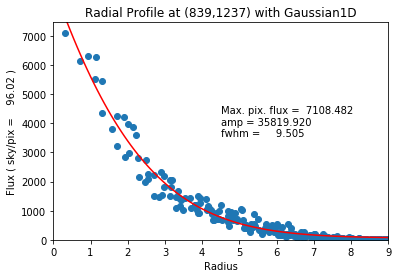

xc=1573.4153	yc=1367.5439
Background per pixel: 91.11661581460072
Max. pix. flux =  4734.789
amp = 57397.866
fwhm =    11.967


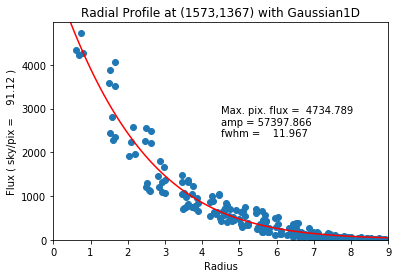

xc=759.6640	yc=875.9449
Background per pixel: 100.47855852687165
Max. pix. flux = 12963.109
amp = 102895.431
fwhm =    10.733


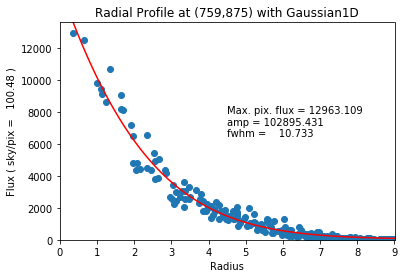

xc=316.6085	yc=706.5355
Background per pixel: 85.78689377669538
Max. pix. flux =  3295.541
amp = 59972.101
fwhm =    11.048


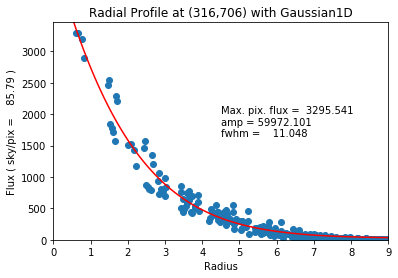

xc=1019.1238	yc=1103.6026
Background per pixel: 159.5875337352845
Max. pix. flux = 52848.695
amp = 455825.363
fwhm =    11.033


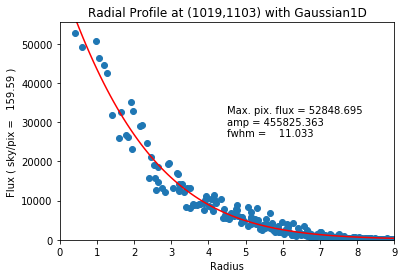

xc=1126.2608	yc=1099.9213
Background per pixel: 105.88759858475188
Max. pix. flux =  8949.531
amp = 26648.578
fwhm =     9.039


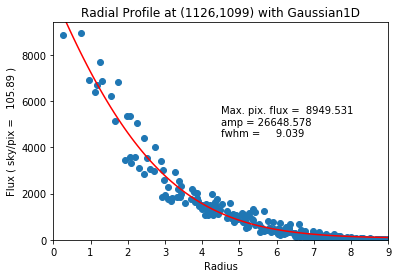

In [712]:
#CLD first doing 159
viewer.imexam()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/carriedrake/Documents/Graduate School/obs_astro/imaging/reduced_data/a160otbf.fits
xc=1049.2143	yc=1211.3484
Background per pixel: 42.58769419643686
Max. pix. flux =   409.312
amp =   722.417
fwhm =     8.459


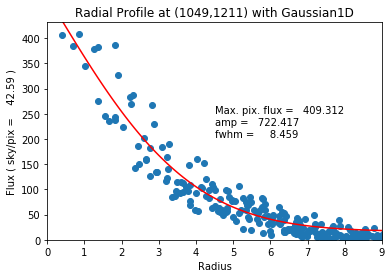

xc=916.5849	yc=1034.5210
Background per pixel: 41.27929985550837
Max. pix. flux =  1163.285
amp =  2721.144
fwhm =     9.499


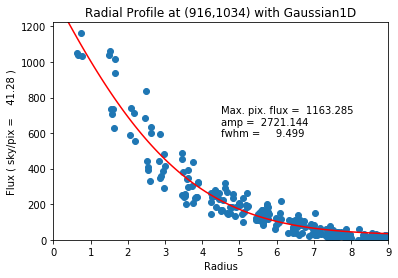

xc=1543.2512	yc=1099.9806
Background per pixel: 49.15693695941314
Max. pix. flux =  4819.923
amp =  9093.692
fwhm =     9.563


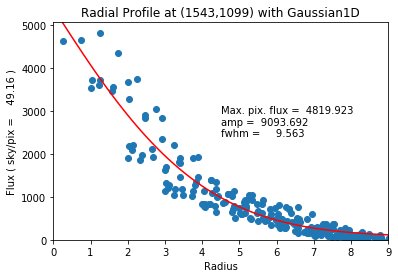

xc=1618.9985	yc=1443.3175
Background per pixel: 40.0476533110257
Max. pix. flux =  1013.794
amp =  1342.075
fwhm =     7.793


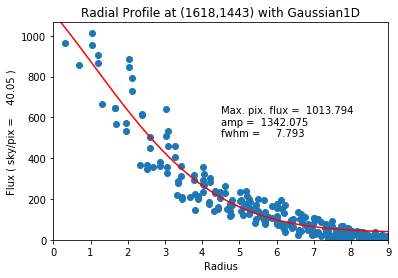

xc=306.8455	yc=1222.9542
Background per pixel: 38.22423624812669
Max. pix. flux =  2004.241
amp =  3531.076
fwhm =     8.479


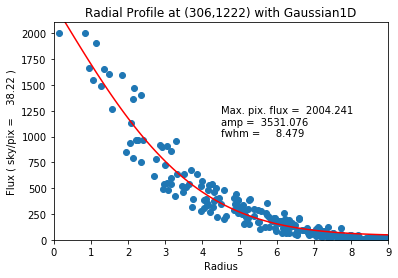

xc=225.5671	yc=532.8552
Background per pixel: 53.73405806373669
Max. pix. flux = 10273.525
amp = 49625.592
fwhm =    11.535


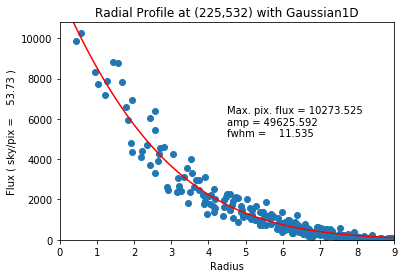

In [713]:
#CLD now doing 160
viewer.imexam()

Contrary to what I first said, it does seem as if a different FWHM is needed based on the above imexam results. From office hours, this is most likely because there is some noise in the data and these are not the real FWHM. This can be seen most noticeably in the graphs that return a FWHM of 11 which is not even on the graph. Because of this, I will visually select the FWHM from the graphs, and this seems to be about 6.

In [856]:
#CLD using daostar finder to find all of the sources in the V image
v_sources = []
mean, median, std = sigma_clipped_stats(v_ngc, sigma=3.0)
daofind = DAOStarFinder(fwhm=7.0, threshold=5.*std) #CLD needed to increase the FWHM for airmass reasons?
sources = daofind(v_ngc-median)
for col in sources.colnames:  
    sources[col].info.format = '%.8g'
v_sources.append(sources)

In [857]:
#CLD using daostar finder to find all of the sources in the B image
b_sources = []
mean, median, std = sigma_clipped_stats(b_ngc, sigma=3.0)
daofind = DAOStarFinder(fwhm=7.0, threshold=5.*std) #CLD needed to increase the FWHM for airmass reasons?
sources = daofind(b_ngc-median)
for col in sources.colnames:  
    sources[col].info.format = '%.8g'
b_sources.append(sources)

In [858]:
#CLD as the airmass is the same we only need one airmass variable
airmass = 1.09

#CLD setting arrays of just the mags 
v_mags = v_sources[0]['mag']
b_mags = b_sources[0]['mag']

v_mags = np.asarray(v_mags)
b_mags = np.asarray(b_mags)

#CLD making x,y arrays for all of the sources
v_x = v_sources[0]['xcentroid']
v_y = v_sources[0]['ycentroid']

b_x = b_sources[0]['xcentroid']
b_y = b_sources[0]['ycentroid']

In [747]:
#CLD matching these with some threshold. To find this thresehold I will use imexam on one star in both frames to get 
#CLD the general range of threshold I might need. Then will use and np.where function on the x and y centroids 
#CLD to effectively crossmatch a majority of the stars in the B and V images
viewer = imexam.connect(path='/Volumes/Macintosh HD/Applications/SAOImageDS9.app/Contents/MacOS/ds9')

In [748]:
viewer.scale()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/carriedrake/Documents/Graduate School/obs_astro/imaging/reduced_data/a159otbf.fits
xc=918.2928	yc=1035.4049
Background per pixel: 89.99696996206133
Max. pix. flux =  3962.448
amp = 54028.321
fwhm =    11.430


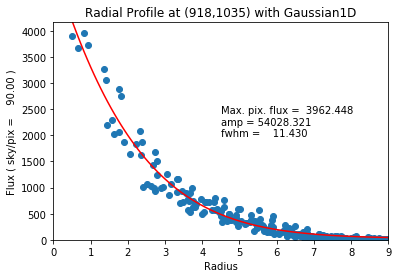

In [749]:
viewer.imexam()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/carriedrake/Documents/Graduate School/obs_astro/imaging/reduced_data/a160otbf.fits
xc=916.5892	yc=1034.5212
Background per pixel: 41.27910504954051
Max. pix. flux =  1163.286
amp =  2675.640
fwhm =     9.437


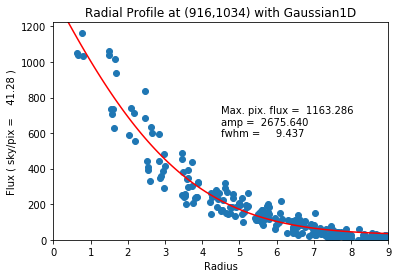

In [750]:
viewer.imexam()

From the above plots, it seems as if x moves by about 2 and y move by about 1. To start with xmatching then, I will use a lenint range for 3.

In [1000]:
#CLD beginning the xmatching 
match_v = []
match_b = []
for x,y in zip(v_x, v_y):
    xmatch = np.where((x>b_x-2)&(x<b_x+2)&(y>b_y-1)&(y<b_y+1)) #CLD these thresholds were as lenint as I could go
    #CLD without having multiple indices for some, means I'm losing a fair amount of stars but hopefully
    #CLD still enough for this hw
    xmatch = np.array(xmatch[0])
    if xmatch.size>0 and xmatch.size<2:
        match_v.append(xmatch[0])
        
for x,y in zip(b_x, b_y):
    xmatch = np.where((x>v_x-2)&(x<v_x+2)&(y>v_y-1)&(y<v_y+1))
    xmatch = np.array(xmatch[0])
    if xmatch.size>0 and xmatch.size<2:
        match_b.append(xmatch[0])

In [1001]:
#CLD checking to make sure that all of the sources in b are being matched with sources in v and vice versa
print(len(match_b))
print(len(match_v))

778
778


In [1012]:
#CLD applying the mask from above
v_mags_x = v_mags[match_b]
b_mags_x = b_mags[match_v]

#CLD atmospheric extinciton correcting these mags
v_mags_e = v_mags_x + k_v*airmass
b_mags_e = b_mags_x + k_b*airmass


#CLD correcting these mags to the standard system
v_mags_es = v_mags_e + v_0 + (v_m*(b_mags_e - v_mags_e))
b_mags_es = b_mags_e + b_0 + (b_m*(b_mags_e - v_mags_e))

#CLD dust extinction correction using dustmaps and what have you
#CLD for the galactic coords, I'm just going to generally use the NGC6823 gal coords
ngc = SkyCoord('19:43:09', '+23:18:00', unit=[u.hour, u.deg])
dustdir = './sfddata/'
m = sfdmap.SFDMap(dustdir, scaling=1)
ebv = m.ebv(ngc.galactic.l.value, ngc.galactic.b.value, frame='galactic')

#CLD the centeral wavelengths for B and V in angstroms
wave = np.array([4344,5456], dtype='double')
A = extinction.ccm89(wave, a_v=1, r_v=3.1) #CLD this extinction correction is based off of the paper we were told to follow
#CLD in the hw document. arguments passed are wave, A_V, and R_V all of which come from the paper
#CLD A_v is 1 because standardized to that. R_v is 3.1

#CLD applying these extinction corrections to the mags
v_mags_esa = v_mags_es - A[1]
b_mags_esa = b_mags_es - A[0]

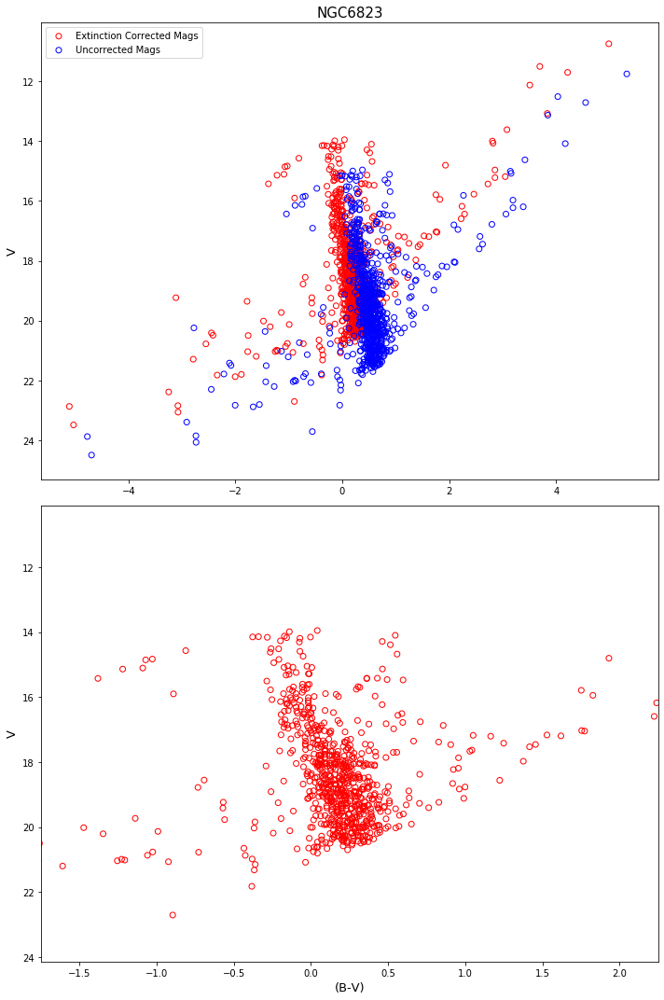

In [1014]:
#CLD now plotting the CMD
fig,ax = plt.subplots(2,1,figsize=(10,15))
ax[0].scatter((b_mags_esa - v_mags_esa), v_mags_esa, facecolors='none', edgecolors='r', label='Extinction Corrected Mags')
ax[0].scatter((b_mags_es - v_mags_es), v_mags_es, facecolors='none', edgecolors='b', label='Uncorrected Mags')
ax[1].scatter((b_mags_esa - v_mags_esa), v_mags_esa, facecolors='none', edgecolors='r')
ax[0].invert_yaxis()
ax[1].invert_yaxis()
ax[1].set_xlabel('(B-V)', fontsize=13)
ax[0].set_ylabel('V', fontsize=13)
ax[1].set_ylabel('V', fontsize=13)
ax[0].set_title('NGC6823', fontsize=15)
ax[1].set_xlim(-1.75,2.25)
ax[0].legend()
fig.tight_layout()
plt.show(fig);



<img src="ngc6823_cmd.png"> 

(Comparing data to CMD in top right corner. Image taken from Rangwal et al 2017)

Firstly, it is quite clear that there are a fair amount of interlopers in my CMD, which are depicted by the sources with high spread compared to the centeral clustering of sources. This is most likely due to my selection of sources being indiscrimant of things like color and calculated distance. To remove these, you would have to do an interative process that slowly narrows down the color space of the sources you are plotting. For the purposes of this hw, I choose to simply zoom in on the main cluster as seen in the final plot.

From published NGC6823 CMD using the B and V filters, my CMD does in fact follow the same general curvature. There are some points missing at the top and bottom however, so it seems that my method of pulling stars is not complete. The extinction correction or the base mags for this cluster, at least in the V, seem to be slightly off from the published data as well. Further, when comparing the (B-V) color, my cluster is offset from the published data. The published data seems to have a central color of 1.2 ish, while mine is closer to 0.25. 